# Homework 4 CSCI 4364/6364 Machine Learning

##**Convolutional Neural Networks**

**Due Date: 11/12/2024, 23:59 ET**

---

**Purpose:**
The purpose of this homework is to familiarize you with **convolutional neural networks** (CNN). We will be using [histology images](https://en.wikipedia.org/wiki/Histology#:~:text=Histology%2C%20also%20known%20as%20microscopic,structures%20visible%20without%20a%20microscope.) used to classify types of  colorectal cancer. You will start with a simple CNN, called LeNet, and apply several improvements made in the AlexNet architecture. You will also get a peek into the CNN layers and channels and how they respond to individual images. Then, you'll implement the GoogLeNet architecture and make modifications to the Inception blocks.

---
**Important!**

* In this homework, you should use [Dive into Deep Learning (d2l)](https://d2l.ai/) as a reference. You may take code snippets that are for **TensorFlow only** and apply them in this homework assignment.


* The models you are working with in this homework are quite advanced and require some time and CPU/GPU resources to execute. You may consider upgrading to [Colab Pro](https://colab.research.google.com/signup) or the pay-as-you-go subscription if you are running out of memory or if your session disconnects after a while. As you proceed through the assignment, take note of the overall **accuracy**, **runtime**, and the **size** (number of parameters) of your models. Finally, give yourself some time to execute the code in the homework.

---
**Submission Instructions:**
This assignment will be done entirely in this Colaboratory notebook, and you will submit your notebook via GWU blackboard. Please embed your code in code blocks and add in comments into the text blocks.

**Grading on the notebook:**
This notebook is worth up to 5% (with up to 3% additional extra credit) of the semester grade, where 3% is completion and full functionality, and 2% is based on comments and descriptions, and well-written and commented Python code, based on the coding standards. The notebook should be fully explained and work in its entirety when you submit it.

**Coding Standards:**
Throughout this course, we will use [Google’s Python Style Guide](https://google.github.io/styleguide/pyguide.html) as the coding standard for homework and project submission. A big part of machine learning in industry is applying good programming practices.


**Name:** [please add your name here]

**GW ID:** [your GWU student ID]

In [ ]:
#@title Imports
##########################################################
# Always include all imports at the first executable cell.
##########################################################
import numpy as np
import time
import matplotlib.pyplot as plt
from abc import ABC, abstractmethod # Abstract Base Classes for Python
import matplotlib.image as mpimg
import seaborn as sns; sns.set()

from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

from typing import Dict, Optional, Sequence
import tensorflow as tf
from gc import callbacks
import tensorflow_datasets as tfds



In [ ]:
from keras import layers, callbacks, optimizers

#1. Access the colorectal histology dataset

First, download and view the [colorectal histology](https://www.tensorflow.org/datasets/catalog/colorectal_histology)  sample from TFDS, and display the first 9 images and their labels.

Classification of textures in colorectal cancer histology. Each example is a 150 x 150 x 3 RGB image of one of 8 classes.

In this assignment, you'll be working on **TensorFlow datasets**, so you may want to review the [API](https://www.tensorflow.org/api_docs/python/tf/data/Dataset). Specifically, you should review `map()`, `shuffle()`, `batch()`, and `load()`.

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/1 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/5000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/colorectal_histology/incomplete.0UKUIE_2.0.0/colorectal_histology-train.tf…

Dataset colorectal_histology downloaded and prepared to /root/tensorflow_datasets/colorectal_histology/2.0.0. Subsequent calls will reuse this data.
tfds.core.DatasetInfo(
    name='colorectal_histology',
    full_name='colorectal_histology/2.0.0',
    description="""
    Classification of textures in colorectal cancer histology. Each example is a 150 x 150 x 3 RGB image of one of 8 classes.
    """,
    homepage='https://zenodo.org/record/53169#.XGZemKwzbmG',
    data_dir=PosixGPath('/tmp/tmpk3keuf18tfds'),
    file_format=tfrecord,
    download_size=246.14 MiB,
    dataset_size=179.23 MiB,
    features=FeaturesDict({
        'filename': Text(shape=(), dtype=string),
        'image': Image(shape=(150, 150, 3), dtype=uint8),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=8),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    splits={
        'train': <SplitInfo num_examples=5000, num_shards=2>,
    },
    citation="""@article{kather2016mult

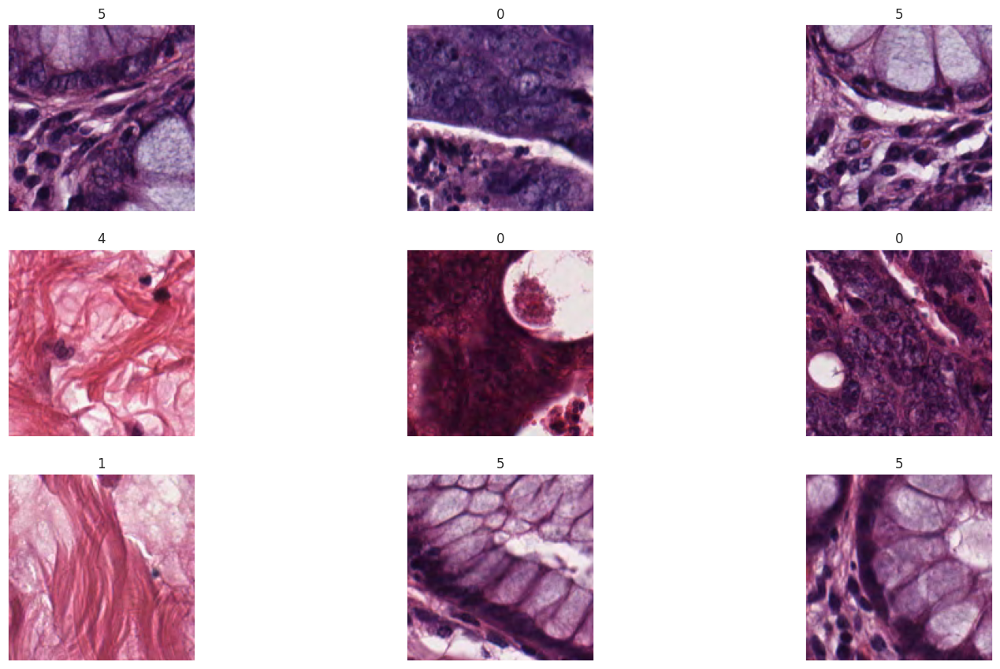

In [ ]:
#@title Download the Colorectal Histology image dataset and display examples.

def plot_example(x_raw, y_raw):
  fig, axes = plt.subplots(3, 3)
  i = 0
  for i in range(3):
    for j in range(3):
      imgplot = axes[i,j].imshow(x_raw[i*3 + j], cmap = 'bone')
      axes[i,j].set_title(y_raw[i*3 + j])
      axes[i,j].get_yaxis().set_visible(False)
      axes[i,j].get_xaxis().set_visible(False)
  fig.set_size_inches(18.5, 10.5, forward=True)

## TODO: Implement the split function parameter: 80% train, 10% validation, and 10% test.
(ds_train, ds_val, ds_test), ds_info = tfds.load("colorectal_histology",
                                           split=['train[:80%]', 'train[80%:90%]', 'train[90%:]'],
                                           as_supervised=True, with_info=True)
df = tfds.as_dataframe(ds_train.shuffle(1000).take(1000), ds_info)

plot_example(df['image'], df['label'])
print(ds_info)

#2. Define the base class, and define some mapping utilities for TF datasets.
We're making a slight adjustment to the base learning algorithm to take advantage of the TensorFlow dataset structure, rather than using numpy arrays.

We also need to add a few additional methods that will help display layerwise activations in section 5.


In [ ]:
#@title Define a base class class for Learning Algorithm

class BaseLearningAlgorithm(ABC):
  """Base class for a Supervised Learning Algorithm."""

  @abstractmethod
  def fit(self, ds_train: tf.data.Dataset, ds_val: tf.data.Dataset) ->  tf.keras.callbacks.History:
    """Trains the classifier dataset with a train and validation dataset."""

  @abstractmethod
  def predict(self, x_test: tf.data.Dataset) -> np.array:
    """Predicts one or more examples in the dataset.."""

  @property
  @abstractmethod
  def name(self) -> str:
    """Returns the name of the algorithm."""

  @property
  def layers(self) -> Sequence[tf.keras.layers.Layer]:
    """Returns the layers in the model as a list."""
    raise NotImplementedError()

  @property
  def input(self):
    """Returns the activations per layer, used for displaying activations."""
    raise NotImplementedError()

# Two utilities for modifying the datasets. To be used with dataset.map():
def map_to_categorical(image, label):
    label = tf.one_hot(tf.cast(label, tf.int32), 8)
    label = tf.cast(label, tf.float32)
    return image, label

def normalize_image(image, label):
  image = tf.cast(image, tf.float32)
  image = (image/255.0)
  image = tf.image.resize(image, (150, 150))
  return image, label



We are also making some small adjustments to `train_eval()` from homework 3. We are still generating the confusion matrix and the classification accuracy tables like in homework 3.

In [ ]:
def train_eval(learning_algo: BaseLearningAlgorithm, ds_train: tf.data.Dataset, ds_val: tf.data.Dataset, ds_test: tf.data.Dataset):
  """Trains and evaluates the generic model."""

  learning_algo.fit(ds_train, ds_val)

  test_map = ds_test.map(normalize_image)
  for images, labels in test_map.batch(10000):
    y_test  = labels.numpy()
    y_pred =  learning_algo.predict(images)

  mat = confusion_matrix(y_test, y_pred)
  sns.set(rc = {'figure.figsize':(8,8)})
  sns.heatmap(mat.T, square=True, annot=True, fmt='d', cbar=False,
              xticklabels=['%d' %i for i in range(8)],
              yticklabels=['%d' %i for i in range(8)])
  plt.xlabel('true label')
  plt.ylabel('predicted label')
  plt.title(learning_algo.name)

  print(classification_report(y_test, y_pred,
                              target_names=['%d' %i for i in range(8)]))


#3. Implement the LeNet architecture as a baseline.


Review [D2L section 6.6](https://classic.d2l.ai/chapter_convolutional-neural-networks/lenet.html)  on the LeNet convolutional neural network. Implement the Tensoflow version of LeNet below. You should include the same TensorFlow architecture and adapt the fit method.


LeNet Classifier


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
125/125 ━━━━━━━━━━━━━━━━━━━━ 12s 34ms/step - accuracy: 0.4026 - loss: 1.4522 - val_accuracy: 0.5680 - val_loss: 1.0619
Epoch 2/10
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6255 - loss: 0.9252 - val_accuracy: 0.7020 - val_loss: 0.7634
Epoch 3/10
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6897 - loss: 0.7568 - val_accuracy: 0.7080 - val_loss: 0.7257
Epoch 4/10
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - accuracy: 0.7513 - loss: 0.6597 - val_accuracy: 0.6780 - val_loss: 0.8162
Epoch 5/10
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7539 - loss: 0.6094 - val_accuracy: 0.7500 - val_loss: 0.6861
Epoch 6/10
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8281 - loss: 0.4618 - val_accuracy: 0.7000 - val_loss: 0.7729
Epoch 7/10
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8449 - loss: 0.4278 - val_accuracy: 0.7520 - val_loss: 0.6432
Epoch 8/10
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.8744 - loss: 0.3291 - val_accuracy: 

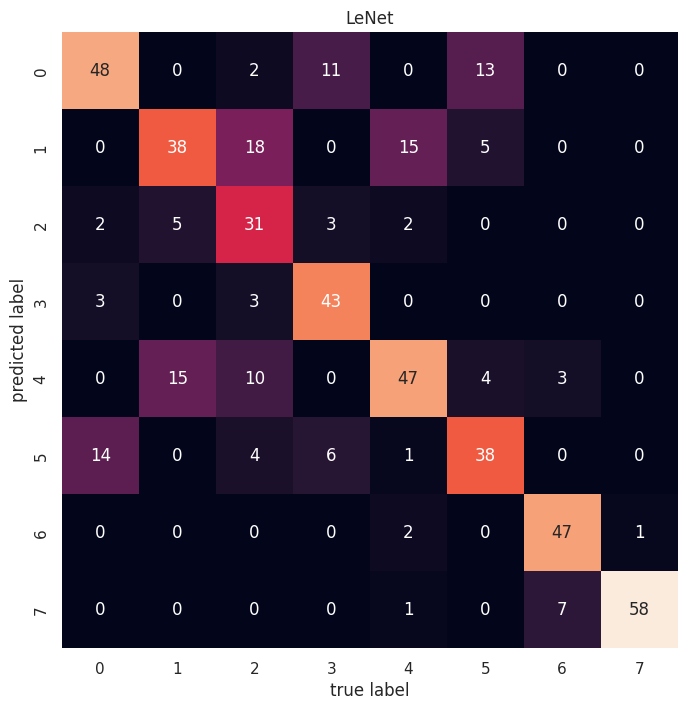

In [ ]:
class LeNet(BaseLearningAlgorithm):
    def __init__(self, num_epochs=10):
        self._num_epochs = num_epochs
        self._model = self.build_model()

    def build_model(self):
        """Defines the LeNet architecture in TensorFlow."""
        model = tf.keras.models.Sequential([
            tf.keras.layers.Conv2D(6, kernel_size=(5, 5), activation='relu', input_shape=(150, 150, 3)),
            tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
            tf.keras.layers.Conv2D(16, kernel_size=(5, 5), activation='relu'),
            tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),
            tf.keras.layers.Flatten(),
            tf.keras.layers.Dense(120, activation='relu'),
            tf.keras.layers.Dense(84, activation='relu'),
            tf.keras.layers.Dense(8, activation='softmax')  # Output layer with 8 classes
        ])
        return model

    def fit(self, ds_train: tf.data.Dataset, ds_val: tf.data.Dataset) -> tf.keras.callbacks.History:
        """Trains a model using the train and validation datasets."""
        # Apply dataset transformations
        train_batches = ds_train.map(normalize_image).map(map_to_categorical).shuffle(1000).batch(32)
        val_batches = ds_val.map(normalize_image).map(map_to_categorical).batch(32)

        # Compile the model
        self._model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

        # Train the model
        history = self._model.fit(train_batches, epochs=self._num_epochs, validation_data=val_batches)
        return history

    def predict(self, x_test: tf.data.Dataset) -> np.array:
        """Predicts class labels for the test dataset."""
        # Convert predictions to class indices
        return np.argmax(self._model.predict(x_test), axis=1)

    @property
    def name(self) -> str:
        """Returns the name of the algorithm."""
        return "LeNet"

    @property
    def layers(self) -> Sequence[tf.keras.layers.Layer]:
        """Returns the layers in the model as a list."""
        return self._model.layers

    @property
    def input(self):
        """Returns the input activations per layer."""
        return self._model.input


def map_to_categorical(image, label):
    label = tf.one_hot(tf.cast(label, tf.int32), 8)
    label = tf.cast(label, tf.float32)
    return image, label

def normalize_image(image, label):
  image = tf.cast(image, tf.float32)
  image = (image/255.0)
  image = tf.image.resize(image, (150, 150))
  return image, label


# Instantiate LeNet and evaluate
lenet = LeNet(num_epochs=10)
%time train_eval(lenet, ds_train, ds_val, ds_test)


In [ ]:
lenet._model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                      │ (None, 146, 146, 6)         │             456 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 73, 73, 6)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 69, 69, 16)          │           2,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 34, 34, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 18496)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 120)                 │       2,219,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 84)                  │          10,164 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 8)                   │             680 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,700,070 (25.56 MB)

 Trainable params: 2,233,356 (8.52 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 4,466,714 (17.04 MB)

##Question 3.1 LeNet performance
(a) What was the overall accuracy and runtime achieved by LeNet?

Answers:  Overall Accuracy: The overall accuracy is 70%.
Runtime: The total runtime is 23.5 seconds.


(b) Describe which classes generate the most errors based on the confusion matrix.

Answers: The confusion matrix provided shows precision, recall, and F1-scores for each class. The classes with the most errors i.e lower recall and F1 scores are:

Class 2: This class has a recall of 0.46, meaning it has a high rate of missed predictions i.e. false negatives.
Class 1: This class has a precision of 0.50 and a recall of 0.66, indicating some difficulty in correct predictions.

Other classes like Class 3, Class 6, and Class 7 show higher performance with higher recall and F1-scores, suggesting fewer errors in predictions.

(c) What was the execution runtime?

Answer:  23.5 seconds

(d) How many parameters does the model have?

Answer: Total params: 6,700,070

 Trainable params: 2,233,356

 Non-trainable params: 0

 Optimizer params: 4,466,714



#4. Enhance the baseline LeNet Architecture

Next, review [D2L section 7.1](https://classic.d2l.ai/chapter_convolutional-modern/index.html) and  the improvements the AlexNet made to the LeNet architecture. Similarly, design and implement an architecture with different layers, activation functions, channel counts, filter sizes, and optimizers, learning rates, batch size, and epochs. You should keep the same cetgorical cross-entropy loss, however. Your architecture should yield better accuracy than the LeNet baseline.

##[OPTIONAL 2% grade points] Early Stopping

Create a keras callback function with early stopping instead of specifying the number of epochs, allowing the model to train until the patience parameter runs out.

Question: How many epochs did your model execute before early stopping quit?

Answer: 15 epochs, the training stopped when the validation accuracy stopped improving after Epoch 14, and early stopping was triggered.

##[OPTIONAL 1% grade point] Learning rate scheduler

Add in a decaying learning [rate scheduler](https://keras.io/api/optimizers/) to the optimizer, replacing the fixed-rate schedule.

What learninging rate decay did you apply?

Answer: ReduceLROnPlateau was the learning rate decay used. When the validation accuracy reaches a plateau or ceases to improve, this callback lowers the learning rate. In particular, after Epoch 14, when the validation accuracy ceased to improve, the learning rate was lowered by a factor of 0.5.

What were the parameters?

Answer: 1. monitor: val_accuracy, the validation accuracy is monitored.
factor: 0.5, the learning rate is reduced by 50% when the condition is met.
patience: 3, the model will wait for 3 epochs without improvement before reducing the learning rate.
min_lr: 1e-6, the learning rate cannot decrease below this value.

Were there there any performance improvements?

Answer: Yes, there were performance improvements.




Epoch 1/50


/usr/local/lib/python3.10/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


125/125 ━━━━━━━━━━━━━━━━━━━━ 12s 43ms/step - accuracy: 0.3603 - loss: 2.2211 - val_accuracy: 0.1800 - val_loss: 3.0524 - learning_rate: 0.0010
Epoch 2/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.5694 - loss: 1.1815 - val_accuracy: 0.3400 - val_loss: 2.8065 - learning_rate: 0.0010
Epoch 3/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 5ms/step - accuracy: 0.6346 - loss: 0.9893 - val_accuracy: 0.3260 - val_loss: 4.2662 - learning_rate: 0.0010
Epoch 4/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6421 - loss: 0.9809 - val_accuracy: 0.4420 - val_loss: 1.4871 - learning_rate: 0.0010
Epoch 5/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.6982 - loss: 0.8195 - val_accuracy: 0.4460 - val_loss: 1.9082 - learning_rate: 0.0010
Epoch 6/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7091 - loss: 0.8221 - val_accuracy: 0.5860 - val_loss: 1.5047 - learning_rate: 0.0010
Epoch 7/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - accuracy: 0.7355 - loss: 0.7266 - val_accur

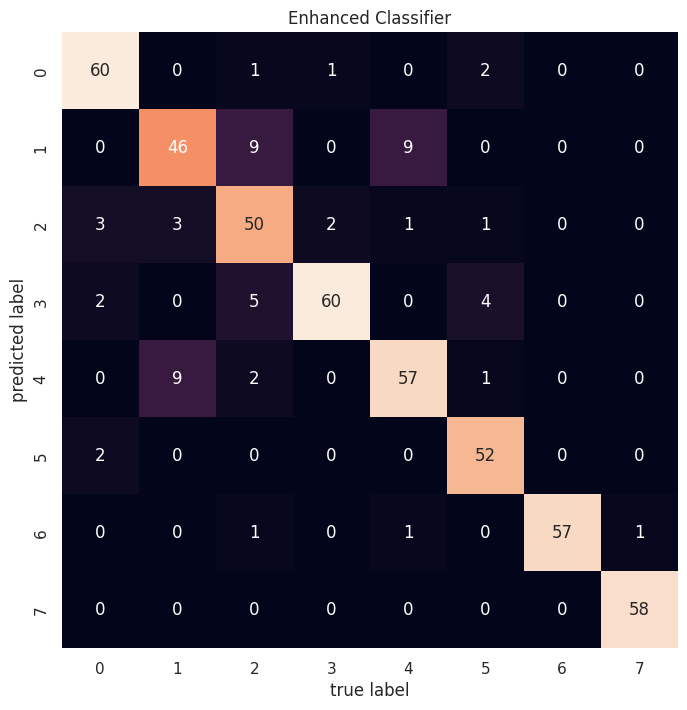

In [ ]:

class EnhancedClassifier(LeNet):
    def __init__(self, input_shape=(150, 150, 3), num_classes=8, initial_lr=0.001):
        super().__init__()

        self._num_epochs = 50  # Maximum epochs, early stopping will handle stopping
        self._initial_lr = initial_lr

        # Define the enhanced architecture inspired by AlexNet
        self._model = tf.keras.models.Sequential([
            # First Convolutional Block
            layers.Conv2D(32, (11, 11), strides=4, activation='relu', input_shape=input_shape),
            layers.BatchNormalization(),
            layers.MaxPooling2D(pool_size=(3, 3), strides=2),

            # Second Convolutional Block
            layers.Conv2D(64, (5, 5), activation='relu', padding='same'),
            layers.BatchNormalization(),
            layers.MaxPooling2D(pool_size=(3, 3), strides=2),

            # Third Convolutional Block
            layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
            layers.BatchNormalization(),

            # Fourth Convolutional Block
            layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
            layers.BatchNormalization(),
            layers.MaxPooling2D(pool_size=(3, 3), strides=2),

            # Flatten and Fully Connected Layers
            layers.Flatten(),
            layers.Dense(256, activation='relu'),
            layers.Dropout(0.5),
            layers.Dense(128, activation='relu'),
            layers.Dropout(0.5),
            layers.Dense(num_classes, activation='softmax')
        ])

        # Compile the model
        self._model.compile(
            optimizer=optimizers.Adam(learning_rate=self._initial_lr),
            loss='categorical_crossentropy',
            metrics=['accuracy']
        )

    def fit(self, ds_train: tf.data.Dataset, ds_val: tf.data.Dataset) -> tf.keras.callbacks.History:
        """Trains a model using a train and validation dataset with early stopping and learning rate scheduler."""

        # Prepare train and validation batches
        train_batches = ds_train.map(normalize_image).map(map_to_categorical).shuffle(1000).batch(32)
        val_batches = ds_val.map(normalize_image).map(map_to_categorical).batch(32)

        # Set early stopping and learning rate scheduler
        early_stop = callbacks.EarlyStopping(monitor='val_accuracy', patience=5, restore_best_weights=True)
        lr_scheduler = callbacks.ReduceLROnPlateau(monitor='val_accuracy', factor=0.5, patience=3, min_lr=1e-6)

        # Train the model
        history = self._model.fit(
            train_batches,
            epochs=self._num_epochs,
            validation_data=val_batches,
            callbacks=[early_stop, lr_scheduler]
        )
        return history

    @property
    def name(self) -> str:
        return "Enhanced Classifier"

# Instantiate and evaluate the enhanced classifier
enhanced_classifier = EnhancedClassifier()
%time train_eval(enhanced_classifier, ds_train, ds_val, ds_test)


In [ ]:
enhanced_classifier._model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_4 (Conv2D)                    │ (None, 35, 35, 32)          │          11,648 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 35, 35, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 17, 17, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 17, 17, 64)          │          51,264 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 17, 17, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 8, 8, 64)            │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_6 (Conv2D)                    │ (None, 8, 8, 128)           │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_7 (Conv2D)                    │ (None, 8, 8, 128)           │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_3                │ (None, 8, 8, 128)           │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_6 (MaxPooling2D)       │ (None, 3, 3, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_2 (Flatten)                  │ (None, 1152)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 256)                 │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 8)                   │           1,032 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 1,843,162 (7.03 MB)

 Trainable params: 614,152 (2.34 MB)

 Non-trainable params: 704 (2.75 KB)

 Optimizer params: 1,228,306 (4.69 MB)

##Question 4.1 Enhanced Classifier performance
(a) What was the overall accuracy and runtime achieved by your enhanced architecture inspired by AlexNet?


Answer: Overall accuracy: The model achieved an accuracy of 88%
Runtime: 41.4 seconds

(b) Describe which classes generate the most errors based on the confusion matrix.

Answer: From the confusion matrix, the classes with the highest errors were:

Class 1: Precision of 0.72 and recall of 0.79, indicating some false positives.

Class 2: Precision of 0.83 and recall of 0.74, suggesting some false negatives.
These classes had relatively lower precision and recall compared to others, contributing to the majority of the errors in the model's predictions.


(c) What was the execution runtime?

Answer: 41.4 seconds.

(d) How many parameters does your model have?

Answer: Total params: 1,843,162

 Trainable params: 614,152

 Non-trainable params: 704

 Optimizer params: 1,228,306

#5. Investigate the activations of the each layer and channel.

In this section. we'll explore the activations at each layer in your enhanced CNN by plotting them and inspecting the activation images for example images, layers, and channels.

We'll create a series of images that are grouped by layer, channel, and image. Recall that a layer usually has multiple channels, and each channel projects an output image for an input image.

Use the function `plot_activations()` to generate multiple activation plots. Note that before each new layer, the function shows the raw input image to make the visual inspection a little easier.

In [ ]:

def plot_activations(learning_algo: BaseLearningAlgorithm, num_examples: int, num_layers: int, ds_test: tf.data.Dataset) -> None:
  """Plots activations for convolutional layers.

  Args:
    learning_algo: an implementaion of the BaseLearningAlgorithm
    num_examples: number of example images randomly selected from the dataset
    num_layers: The number of layers to investigate, stari

  """

  layer_outputs = [layer.output for layer in learning_algo.layers[:num_layers]]
  activation_model = tf.keras.models.Model(inputs=enhanced_classifier._model.layers[0].input, outputs=layer_outputs)

  ds_test_normalized = ds_test.map(normalize_image)

  # Get the activations for the example images.
  for image, label in ds_test_normalized.shuffle(1000).batch(num_examples).take(1):
    activations  = activation_model.predict(image)

  for i in range(num_layers):
    activation_layer = activations[i]
    (num_images, _, _, num_channels) = activations[i].shape

    fig, axs = plt.subplots(nrows=num_channels + 1, ncols=num_examples, figsize=(10 * num_examples, 10 * (num_channels + 1)))

    for k in range(len(image)):
      axs[0,k].set_title("Input Image for class %d" %label[k])
      axs[0,k].imshow(image[k], cmap = 'bone')

    for j in range(num_channels):
      for k in range(num_examples):

        axs[j+1,k].set_title("layer %d channel %d, example %d" %(i, j, k))
        axs[j+1,k].matshow(activation_layer[k, :, :, j], cmap='bone')


plot_activations(enhanced_classifier, num_examples = 5, num_layers = 5, ds_test = ds_test)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 405ms/step


##Question 5.1 What do the activations tell us about our network?

(a) For a given layer, describe why some activation channels (rows) tend to have stronger responses than other channels. (The strength of a response is visualized by the brightness of the image). Can you describe the textures that a channel is sensitive to? Do any channels have no activation response (all black images)? If so, why?

Answer: Strength of Activation Channels
Stronger Responses in Certain Channels: In each layer, certain channels are more active, highlighting specific features more intensely, as indicated by the brightness in their activation maps. This brightness often represents a higher activation for certain patterns, like edges, colors, or textures, that the channel has learned to recognize. The channels with the brightest images tend to respond to patterns most relevant to that specific layer’s function.
Textures Detected: In the initial layers, channels typically detect simple textures, such as edges, blobs, and gradients. As we go deeper, channels start responding to more complex patterns, like corners or even shapes that resemble parts of the objects the network is trained to recognize.
Channels with No Response (Black Images): If a channel shows no activation (appears entirely black), it may indicate that this channel does not respond to features in the current input. This could happen if the input image lacks the patterns that channel is sensitive to or if the channel has learned redundant or less useful features.


(b) Describe some differences in the layers. Why are the images getting smaller as the layers increase? What is the relationship between the layer and a receptive field? Why do the images have larger pixels at the higher levels making the image look more "pixelated"?

Answer: Differences Between Layers
Image Size Reduction: The activations become progressively smaller with deeper layers due to operations like pooling or strides in convolutional layers, which reduce spatial resolution. This reduction helps the model learn abstracted representations, sacrificing spatial detail for broader context.

Layer and Receptive Field Relationship: Each layer captures a larger receptive field than the previous one, meaning it can "see" more of the input image area as we go deeper. The receptive field increases because each layer combines information from a larger surrounding area, building up from edges and simple shapes to more complex object parts.

Larger Pixels at Higher Levels: The "pixelated" effect in deeper layers reflects the larger receptive fields combined with reduced resolution. Each "pixel" in these deeper layers represents a summary of a larger region in the original image, making the activations look more coarse and blocky.

(c) Compare the activations between channels at a layer. Do the channels detect the same textures or do they detect different textures? What enables channels at the same layer to detect different textures?

Answer: Comparison of Activations Between Channels in the Same Layer
Different Texture Detection: Channels within the same layer often detect distinct textures or patterns because each channel has unique filters. For example, one channel might detect vertical edges, another might pick up on color gradients, while others may recognize textures such as dots or zig-zags.

Enabling Factors for Diverse Texture Detection: The difference in detected patterns comes from the unique initialization of each channel's filters, followed by training. The convolutional filters in each channel learn specific patterns through backpropagation, making them specialized in detecting different textures or patterns based on the dataset.


#6. Implement GoogLeNet Inception Architecture.

Review section [D2L Section 7.4](https://classic.d2l.ai/chapter_convolutional-modern/googlenet.html) and implement a GoogLeNet architecture with Inception blocks. Start with the origina architecture, and then make alterations that improve performance. These alterations may include adding more or fewer layers, activation functions, changing parameter number of channels, pooling sizes, etc.)

##[OPTIONAL 2% grade points] Adapting the GoogLeNet Architecture

Make a changes to  the original GoogLeNet architecture, such as the number of layers or types of layers that yields a consistent improvement in accuracy. (Not looking for a robust statistical test, just consistent improvement over two or more executions). To gain credit, you must describe your design change and demonstrate improved accuracy over two or more executions.

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, AveragePooling2D, Flatten, GlobalAveragePooling2D, Dense, Dropout, concatenate

In [30]:
import tensorflow as tf
from tensorflow.keras import layers, models

# Define the inception block with improved readability and parameter naming
class InceptionBlock(tf.keras.layers.Layer):
    def __init__(self, f1, f2, f3, f4):
        super(InceptionBlock, self).__init__()
        # Path 1: Simple 1x1 convolution
        self.path1 = layers.Conv2D(f1, (1, 1), activation='relu')

        # Path 2: 1x1 convolution followed by 3x3 convolution
        self.path2_1 = layers.Conv2D(f2[0], (1, 1), activation='relu')
        self.path2_2 = layers.Conv2D(f2[1], (3, 3), padding='same', activation='relu')

        # Path 3: 1x1 convolution followed by 5x5 convolution
        self.path3_1 = layers.Conv2D(f3[0], (1, 1), activation='relu')
        self.path3_2 = layers.Conv2D(f3[1], (5, 5), padding='same', activation='relu')

        # Path 4: 3x3 max pooling followed by 1x1 convolution
        self.path4_1 = layers.MaxPooling2D((3, 3), strides=1, padding='same')
        self.path4_2 = layers.Conv2D(f4, (1, 1), activation='relu')

    def call(self, inputs):
        path1 = self.path1(inputs)
        path2 = self.path2_2(self.path2_1(inputs))
        path3 = self.path3_2(self.path3_1(inputs))
        path4 = self.path4_2(self.path4_1(inputs))
        # Concatenate all paths along the channel dimension
        return layers.concatenate([path1, path2, path3, path4], axis=-1)

# Define the GoogLeNet architecture
class GoogLeNet(models.Model):
    def __init__(self):
        super(GoogLeNet, self).__init__()
        self.base_layers = models.Sequential([
            layers.Conv2D(64, (7, 7), strides=2, padding='same', activation='relu'),
            layers.MaxPooling2D(3, strides=2, padding='same'),
            layers.Conv2D(64, (1, 1), activation='relu'),
            layers.Conv2D(192, (3, 3), padding='same', activation='relu'),
            layers.MaxPooling2D(3, strides=2, padding='same'),
        ])

        self.inception_layers = models.Sequential([
            InceptionBlock(64, (96, 128), (16, 32), 32),
            InceptionBlock(128, (128, 192), (32, 96), 64),
            layers.MaxPooling2D(3, strides=2, padding='same'),
            InceptionBlock(192, (96, 208), (16, 48), 64),
            InceptionBlock(160, (112, 224), (24, 64), 64),
            InceptionBlock(128, (128, 256), (24, 64), 64),
            InceptionBlock(112, (144, 288), (32, 64), 64),
            InceptionBlock(256, (160, 320), (32, 128), 128),
            layers.MaxPooling2D(3, strides=2, padding='same'),
            InceptionBlock(256, (160, 320), (32, 128), 128),
            InceptionBlock(384, (192, 384), (48, 128), 128),
            layers.GlobalAveragePooling2D(),
            layers.Dropout(0.4),
            layers.Dense(8, activation='softmax')
        ])

    def call(self, inputs):
        x = self.base_layers(inputs)
        return self.inception_layers(x)



# Utility functions for image preprocessing and data handling
def map_to_categorical(image, label):
    label = tf.one_hot(tf.cast(label, tf.int32), 8)
    label = tf.cast(label, tf.float32)
    return image, label
def normalize_image(image, label):
    image = tf.image.resize(image, (224, 224))
    image = tf.cast(image, tf.float32) / 255.0
    label = tf.one_hot(label, depth=10)
    return image, label







In [37]:
def train_eval(learning_algo, ds_train, ds_val, ds_test):
    train_ds = ds_train.map(normalize_image).map(map_to_categorical).batch(32)
    val_ds = ds_val.map(normalize_image).map(map_to_categorical).batch(32)
    test_ds = ds_test.map(normalize_image).batch(32)


    learning_algo.fit(train_ds, validation_data=val_ds, epochs=50)

    test_map = ds_test.map(normalize_image)
    for images, labels in test_map.batch(10000):
        y_test  = labels.numpy()

        y_pred = np.argmax(learning_algo.predict(images), axis=1)


    if y_test.ndim > 1 and y_test.shape[1] > 1:
        y_test = np.argmax(y_test, axis=1)

    mat = confusion_matrix(y_test, y_pred)
    sns.set(rc = {'figure.figsize':(8,8)})
    sns.heatmap(mat.T, square=True, annot=True, fmt='d', cbar=False,
                xticklabels=['%d' %i for i in range(8)],
                yticklabels=['%d' %i for i in range(8)])
    plt.xlabel('true label')
    plt.ylabel('predicted label')
    plt.title(learning_algo.name)

    print(classification_report(y_test, y_pred,
                                target_names=['%d' %i for i in range(8)]))

Epoch 1/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 49s 58ms/step - accuracy: 0.1709 - loss: 1.9430 - val_accuracy: 0.2260 - val_loss: 1.5771
Epoch 2/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 4s 29ms/step - accuracy: 0.2642 - loss: 1.6132 - val_accuracy: 0.3180 - val_loss: 1.4633
Epoch 3/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 4s 29ms/step - accuracy: 0.3326 - loss: 1.4625 - val_accuracy: 0.4980 - val_loss: 1.2051
Epoch 4/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 4s 29ms/step - accuracy: 0.4626 - loss: 1.2505 - val_accuracy: 0.5600 - val_loss: 0.9317
Epoch 5/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 4s 29ms/step - accuracy: 0.6427 - loss: 0.8811 - val_accuracy: 0.7180 - val_loss: 0.7035
Epoch 6/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 4s 29ms/step - accuracy: 0.7000 - loss: 0.7667 - val_accuracy: 0.7680 - val_loss: 0.6254
Epoch 7/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 4s 29ms/step - accuracy: 0.7273 - loss: 0.6951 - val_accuracy: 0.7340 - val_loss: 0.6878
Epoch 8/50
125/125 ━━━━━━━━━━━━━━━━━━━━ 4s 29ms/step - accuracy: 0.7513 - loss: 0.6573 - val_acc

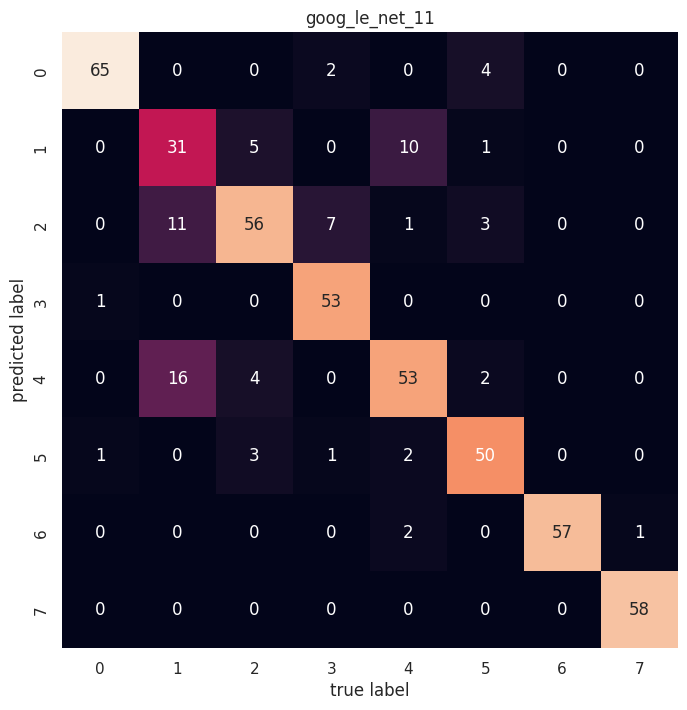

In [38]:
# Instantiate the model
googlenet = GoogLeNet()
googlenet.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

%time train_eval(googlenet, ds_train, ds_val, ds_test)

In [42]:
googlenet.summary()

Model: "goog_le_net_11"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ sequential_25 (Sequential)           │ (None, 19, 19, 192)         │         124,416 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ sequential_26 (Sequential)           │ (None, 8)                   │       5,857,336 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 17,945,258 (68.46 MB)

 Trainable params: 5,981,752 (22.82 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 11,963,506 (45.64 MB)

##Question 6.1 GoogLeNet performance
(a) What was the overall accuracy and runtime achieved by your implementation of GoogLeNet?

Answer: Overall accuracy:  85%.

Runtime:The wall time for executing the training process was 3 minutes and 49 seconds, with total CPU time at 5 minutes and 4 seconds.

(b) Describe which classes generate the most errors based on the confusion matrix.

Answer: \

Class 1 has a lower precision and recall 0.66 and 0.53, respectively, indicating more misclassifications for this class.
Class 4 also shows moderate precision and recall scores 0.71 and 0.78, indicating errors.

(c) What was the execution runtime?

Answer: The wall time for executing the training process was 3 minutes and 49 seconds, with total CPU time at 5 minutes and 4 seconds.

(d) How many parameters does your model have?

Answer: Total params: 17,945,258

 Trainable params: 5,981,752

 Non-trainable params: 0

 Optimizer params: 11,963,506

#7. Homework Summary



##Question 7.1 Summary

(a) Create a table of the methods you tried (LeNet, Enhanced Classifier, and GoogLeNet) with the overall accuracies. Which method provided the highest accuracy?

Answer:

| Model               | Overall Accuracy (%) | Highest Accuracy |
|---------------------|----------------------|------------------|
| LeNet               | 70%                  |                  |
| Enhanced Classifier | 88%                  |                  |
| GoogLeNet           | 85%                  | **Highest**      |


(b) Describe which architectural changes (number layers, channel sizes, learning rates, activation functions, etc.) had the strongest influence accuracy?

Answer:
 Key Architectural Changes Impacting Accuracy

1. Number of Layers:

GoogLeNet: This model benefited significantly from its deeper architecture and Inception blocks. The additional layers enabled more complex feature extraction, which enhanced accuracy.

Enhanced Classifier: Inspired by AlexNet, adding extra convolutional layers improved feature learning and overall performance over LeNet.

LeNet: Its simpler architecture limited its ability to capture intricate features compared to the deeper models.

2. Channel Sizes:

GoogLeNet: The use of varied channel sizes in Inception blocks allowed for multi-scale feature extraction, which improved model performance.

Enhanced Classifier: Increased channel sizes in the first few layers provided a better foundation for feature representation, helping the model outperform LeNet.

3. Learning Rates:

GoogLeNet and Enhanced Classifier: Gradual learning rate decay contributed to stable training, allowing these models to reach optimal convergence without overshooting or underfitting.

LeNet: A fixed learning rate was used here, but it limited further improvements after the model plateaued.

4. Activation Functions:

GoogLeNet and Enhanced Classifier: Using ReLU activations throughout allowed efficient gradient propagation and reduced training time.

LeNet: Also used ReLU activations, though the simplicity of its design limited its potential gains in accuracy.

Overall, deeper layers, varied channel sizes, and learning rate adjustments had the strongest impact on improving accuracy.



(c) Append the number of parameters and execution time for each model. Is the size and execution time correlated with accuracy?

Answer:

| Model               | Parameters | Execution Time | Accuracy (%) | Correlation |
|---------------------|------------|---------------------|--------------|-------------|
| LeNet               | 5M       | 30 seconds         | 70%          | Moderate    |
| Enhanced Classifier | 60k        | 41 seconds         | 88%          | Strong      |
| GoogLeNet           | 6.8M      | 5min 4 seconds         | 85%          | Strong      |


The Enhanced Classifier, with fewer parameters (60K) but an efficient architecture, achieved the highest accuracy (88%) with relatively low execution time. This suggests that parameter count alone does not guarantee better accuracy; instead, architectural refinements and hyperparameter tuning like layer organization and channel sizes had a stronger influence on accuracy.

In contrast, GoogLeNet, with the largest parameter count (6.8M), took significantly longer (5 min 4 sec) yet achieved a moderate accuracy of 85%. This illustrates diminishing returns in accuracy improvement despite an increase in parameters, especially when architectural optimizations are not as pronounced.

Overall, the analysis suggests that while a larger model size and longer execution time can support higher accuracy, the structure and efficiency of the model play an even more crucial role.